#  Install package

In [1]:
# ! pip install pyvis
# ! pip install networkx
# ! pip install openai
# ! pip install contextily
# ! pip install matplotlib_scalebar

# Import package

In [2]:
import os
import requests
import networkx as nx
import pandas as pd
import geopandas as gpd
from pyvis.network import Network
from openai import OpenAI
from IPython.display import display, HTML, Code
from IPython.display import clear_output

import base64

import pickle

import logging

logging.basicConfig(level=logging.WARNING)



# Define Solution class
Please run the following cell to define the functions

In [3]:
%load_ext autoreload
%autoreload 2

import LLM_Cat_Constants as constants
import helper

from LLM_Cat_kernel import Solution

# Demonstration Cases

## Input task and data desciption

In [4]:
# isReview = True
isReview = False

In [5]:
# Case 1
# task_name ='Census_map'
# TASK = r'''1. Create a thematic map to show the Census block group population. The location is Centre County, PA, USA. 
# 2. Carefuly design the map, make it beautiful and aesthetic appeal. The title, north arrow, scalebar, legend, and designer are needed. The designer is "LMM-Cat".
# 3. The map dimension is letter (8*11 inches) size.
# 4. Add a basemap.
# '''



# # Case 2:
# DATA_LOCATIONS = [
#     """Population file, GeoPackage format: E:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\centre_county_CBG.gpkg. Only one layer, no need to load it using a layer name. The population is in the 'totalpopulation' column. The map projection is Lambert Conformal Conic, EPSG 6564, StatePlane Pennsylvania South. The unit is meter.
#     """
# ]

# Case 2:

# task_name = 'map_matrix_annual_GDP'

# TASK = r""" 1. Create a map matrix showing the per capita GDP of South American countries from 2013 to 2022. The matrix has 10 choropleth submaps (2 rows * 5 columns). Each submap shows a year of per capita GDP. You need to use the year as the submap title. 
# 2. Carefully design the map and make it beautiful and aesthetically appealing. The entire map matrix (not each submap) needs a title, a north arrow, a scalebar, a colorbar, and a designer. The designer is 'LMM-Cat'. All submaps should use the same range of colormap.
# 3. The map dimension is the landscape letter (11*8 inches) size, DPI is 150.
# """

# DATA_LOCATIONS = [
# """
# "Country per capita GPD file, GeoPackage format: E:\\OneDrive_PSU\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\ESRI_countries_4326_GDP.gpkg.  Only one layer, no need to load it using a layer name. The map projection is EPSG 4326. The continent column is 'UN_Geodata_simplified_intreg'; 'South America' indicates South America in this column. The GDP columns are named 'country_per_capita_GDP_2013' - 'country_per_capita_GDP_2022'.
# """
# ]
 # The country name column is 'COUNTRY'.

# Case 3:

# task_name = 'map_matrix_annual_GDP'

# TASK = r""" 1. Create a choropleth map to show the per capita GDP of African countries in the year 2022. The map should have two equal-sized parts on the same page. You need to show a large GDP choropleth African continent submap with all African countries on the left part, and another map matrix of 9 rows * 6 columns on the right part, each submap in the map matrix shows an individual country in Africa, ordered by the per capita GDP; the filling color of each country in the map matrix should as the same as its color in the continent map; you need to use the country name as the submap title. 
# 2. Carefully design the map and make it beautiful and aesthetically appealable. The title, north arrow, scalebar, legend, and designer are needed for the Africa map, but not for the map matrix. The designer is 'LMM-Cat'.
# 3. The map dimension is the landscape letter (11*8 inches) size, DPI is 150.
# """

# DATA_LOCATIONS = [
# """
# "Country per capita GPD file, GeoPackage format: E:\\OneDrive_PSU\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\ESRI_countries_4326_GDP.gpkg.  Only one layer, no need to load it using a layer name. The country name column is 'COUNTRY'. The map projection is EPSG 4326. The continent column is 'UN_Geodata_simplified_georeg'; 'AFR' indicates Africa in this column. The 2022 GDP column is 'country_per_capita_GDP_2022'
# """
# ]


# Case 4: Pennsylvania hospital

task_name = 'Pennsylvania_hospitals'

TASK = r"""1. Create a map showing the show the hospital locations in Pennsylvania. 
2. Carefully design the map and make it beautiful and aesthetically appealing. 
3. Use a local map projection of metric unit.
4. The map needs a title, a north arrow, a scalebar, a legend, and a designer. The designer is 'LMM-Cat'. 
5. The map dimension is the landscape letter (11*8 inches) size, DPI is 100.
6. A overview submap in the main map is needed to show the location of Pennsylvania in the USA.
7. Add an OpenStreetMap basemap.
Note that all given data are in GeoPackage format, each .gpkg file has one layer only, no need to load it using a layer name. All the data projection is EPSG 4326. 
"""

DATA_LOCATIONS = [r"""1. Hospital point data: D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_hospital.gpkg.  
2. Pennsylvanina county boundary polygon data: D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_County_boundary.gpkg. 
3. Pennsylvanina state boundary polygon data: D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_State_boundary.gpkg.
4. Contiguous USA boundary polygon data: D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\USA_boundary.gpkg.
"""]



save_dir = os.path.join(os.getcwd(), task_name)
os.makedirs(save_dir, exist_ok=True)

# create graph
# model=r"gpt-4"
# model = r'gpt-4-turbo-preview'
# model = r'gpt-4-turbo'
model = r'gpt-4o'

solution = Solution(
                    task=TASK,
                    task_name=task_name,
                    save_dir=save_dir,
                    data_locations=DATA_LOCATIONS,
                    model=model,
                    )
print("Prompt to get solution graph:\n")
print(solution.graph_prompt)

Prompt to get solution graph:

Your role: A professional cartographer and programmer good at Python. You have worked on cartography for more than 20 years and know every detail and pitfall when visualizing spatial data and coding. You know how to set up workflows for cartography tasks well. You have significant experience in visualizing spatial data and graph theory. You are also experienced in generating maps using Matplotlib, GeoPandas, and other interactive Python packages, such as Plotly.
 

Your task requirements: Generate a graph (data structure) only, whose nodes are a series of consecutive steps to make a map, including visualizing the data and adding map elements such as title, legend, scalebar, label, and annotation. The task requirements are: 
 1. Create a map showing the show the hospital locations in Pennsylvania. 
2. Carefully design the map and make it beautiful and aesthetically appealing. 
3. Use a local map projection of metric unit.
4. The map needs a title, a north 

## Get graph code from GPT API

In [6]:
response_for_graph = solution.get_LLM_response_for_graph() 
solution.graph_response = response_for_graph
solution.save_solution()

clear_output(wait=True)
display(Code(solution.code_for_graph, language='python'))

import networkx as nx

G = nx.DiGraph()

# 1 Load Pennsylvania hospital data
G.add_node("hospital_data_path", 
           node_type="data", 
           data_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_hospital.gpkg", 
           description="Path to hospital locations in Pennsylvania")
G.add_node("load_hospital_data", node_type="operation", description="Load Pennsylvania hospital data into GeoDataFrame")
G.add_edge("hospital_data_path", "load_hospital_data")
G.add_node("hospital_gdf", node_type="data", description="Hospital locations GeoDataFrame in Pennsylvania")
G.add_edge("load_hospital_data", "hospital_gdf")

# 2 Load Pennsylvania county boundary data
G.add_node("county_boundary_path", 
           node_type="data", 
           data_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_County_boundary.gpkg", 
           description="Path to county boundary data in Pennsylvania")
G.add_node("load_county_boundary", node_type="operation", description="Load Pennsylvania county boundary data into GeoDataFrame")
G.add_edge("county_boundary_path", "load_county_boundary")
G.add_node("county_boundary_gdf", node_type="data", description="County boundary GeoDataFrame in Pennsylvania")
G.add_edge("load_county_boundary", "county_boundary_gdf")

# 3 Load Pennsylvania state boundary data
G.add_node("state_boundary_path", 
           node_type="data", 
           data_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_State_boundary.gpkg", 
           description="Path to state boundary data for Pennsylvania")
G.add_node("load_state_boundary", node_type="operation", description="Load Pennsylvania state boundary data into GeoDataFrame")
G.add_edge("state_boundary_path", "load_state_boundary")
G.add_node("state_boundary_gdf", node_type="data", description="State boundary GeoDataFrame for Pennsylvania")
G.add_edge("load_state_boundary", "state_boundary_gdf")

# 4 Load contiguous USA boundary data
G.add_node("usa_boundary_path", 
           node_type="data", 
           data_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\USA_boundary.gpkg", 
           description="Path to contiguous USA boundary data")
G.add_node("load_usa_boundary", node_type="operation", description="Load contiguous USA boundary data into GeoDataFrame")
G.add_edge("usa_boundary_path", "load_usa_boundary")
G.add_node("usa_boundary_gdf", node_type="data", description="Contiguous USA boundary GeoDataFrame")
G.add_edge("load_usa_boundary", "usa_boundary_gdf")

# 5 Project data to a local projection
G.add_node("local_projection", node_type="operation", description="Project all data to a local metric projection (e.g., NAD83 / Pennsylvania North)")
G.add_edge("hospital_gdf", "local_projection")
G.add_edge("county_boundary_gdf", "local_projection")
G.add_edge("state_boundary_gdf", "local_projection")
G.add_node("hospital_projected_gdf", node_type="data", description="Projected hospital locations GeoDataFrame")
G.add_node("county_boundary_projected_gdf", node_type="data", description="Projected county boundary GeoDataFrame")
G.add_node("state_boundary_projected_gdf", node_type="data", description="Projected state boundary GeoDataFrame")
G.add_edge("local_projection", "hospital_projected_gdf")
G.add_edge("local_projection", "county_boundary_projected_gdf")
G.add_edge("local_projection", "state_boundary_projected_gdf")

# 6 Set up map canvas and add elements
G.add_node("setup_map_canvas", node_type="operation", description="Setup map canvas for plotting")
G.add_edge("hospital_projected_gdf", "setup_map_canvas")
G.add_edge("county_boundary_projected_gdf", "setup_map_canvas")
G.add_edge("state_boundary_projected_gdf", "setup_map_canvas")
G.add_node("map_canvas", node_type="data", description="Configured map canvas with landscape letter size and OpenStreetMap basemap")
G.add_edge("setup_map_canvas", "m

## Execute code to generate the solution graph

In [7]:
exec(solution.code_for_graph)
solution_graph = solution.load_graph_file()

# from IPython.core.display import display, HTML
from IPython.display import display, HTML

# from IPython import display, HTML


# Show the graph
G = nx.read_graphml(solution.graph_file)  
nt = helper.show_graph(G)
html_name = os.path.join(os.getcwd(), solution.task_name + '.html')  
# HTML file should in the same directory. See:
# https://stackoverflow.com/questions/65564916/error-displaying-pyvis-html-inside-jupyter-lab-cell
nt.show(name=html_name)
# html_name
# display(HTML(src=html_name, width='100%', height='600px'))
# IFrame(src=html_name, width='100%', height='600px')
# HTML(filename=html_name)
# IFrame(src='https://s3.amazonaws.com/duhaime/blog/visualizations/isolation-forests.html', width=700, height=600)
# html_name
# HTML(nt.write_html(html_name))

D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Pennsylvania_hospitals.html


## Generate prompts and code for operations (functions)

In [8]:
operations = solution.get_LLM_responses_for_operations(review=isReview)
solution.save_solution()

all_operation_code_str = '\n'.join([operation['operation_code'] for operation in operations])

clear_output(wait=True)
display(Code(all_operation_code_str, language='python'))

# Load Pennsylvania hospital data into GeoDataFrame
def load_hospital_data(hospital_data_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_hospital.gpkg'):
    import geopandas as gpd
    
    # Load the hospital data from the GeoPackage file
    hospital_gdf = gpd.read_file(hospital_data_path)
    
    # Return the hospital GeoDataFrame
    return hospital_gdf
# Load Pennsylvania county boundary data into GeoDataFrame
def load_county_boundary(county_boundary_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_County_boundary.gpkg'):
    import geopandas as gpd
    
    # Load the GeoPackage file into a GeoDataFrame
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    
    # Return the loaded GeoDataFrame
    return county_boundary_gdf
import geopandas as gpd

# Description: Load Pennsylvania state boundary data into GeoDataFrame
def load_state_boundary(state_boundary_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf
# Description: Load contiguous USA boundary data into GeoDataFrame
def load_usa_boundary(usa_boundary_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\USA_boundary.gpkg"):
    import geopandas as gpd
    
    # Load the GeoPackage file into a GeoDataFrame
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    
    # Return the GeoDataFrame
    return usa_boundary_gdf
# Description: Project all data to a local metric projection (e.g., NAD83 / Pennsylvania North)
def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    import geopandas as gpd

    # Define the local projection for Pennsylvania (NAD83 / Pennsylvania North)
    pa_projection = 'EPSG:32129'
    
    # Project each GeoDataFrame to the local projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    
    # Return projected GeoDataFrames
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf
# Setup map canvas for plotting
def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    import matplotlib.pyplot as plt
    import contextily as ctx

    # Create a new figure with specified size for landscape letter size
    fig, ax = plt.subplots(figsize=(11, 8))

    # Plot county boundaries
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
    
    # Plot state boundary for Pennsylvania
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
    
    # Plot hospital locations
    hospital_projected_gdf.plot(ax=ax, color='blue', markersize=10, label='Hospitals')
    
    # Add OpenStreetMap basemap
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=hospital_projected_gdf.crs.to_string())

    # Set axis off
    ax.set_axis_off()
    
    # Set aspect
    ax.set_aspect('equal')
    
    # Return the configured map canvas
    return fig, ax
# Description: Add title, north arrow, scalebar, legend, and credits to the map
def add_map_elements(map_canvas):
    import matplotlib.pyplot as plt
    from matplotlib_scalebar.scalebar import ScaleBar

    # Unpack the figure and axis
    fig, ax = map_canvas

    # Add title
    ax.set_title('Hospital Locations in Pennsylvania')

    # Add north arrow
    x, y, arrow_length = 0.1, 0.9, 0.1
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=5, headwidth=15),
                ha='center', va='center', fontsize=12,

## Generate prompts and code for assembly program

In [9]:
assembly_LLM_response = solution.get_LLM_assembly_response(review=isReview)
solution.assembly_LLM_response = assembly_LLM_response
solution.save_solution()

clear_output(wait=True)
display(Code(solution.code_for_assembly, language='python'))

def assembely_solution():
    import geopandas as gpd
    import matplotlib.pyplot as plt
    from matplotlib_scalebar.scalebar import ScaleBar
    import contextily as ctx

    # Load data
    def load_data():
        hospital_gdf = load_hospital_data()
        county_boundary_gdf = load_county_boundary()
        state_boundary_gdf = load_state_boundary()
        usa_boundary_gdf = load_usa_boundary()
        return hospital_gdf, county_boundary_gdf, state_boundary_gdf, usa_boundary_gdf

    # Project data
    def project_data(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
        pa_projection = 'EPSG:32129'
        hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
        county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
        state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
        return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

    # Setup map canvas
    def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
        fig, ax = plt.subplots(figsize=(11, 8))
        county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
        state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
        hospital_projected_gdf.plot(ax=ax, color='blue', markersize=10, label='Hospitals')
        ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=hospital_projected_gdf.crs.to_string())
        ax.set_axis_off()
        ax.set_aspect('equal')
        return fig, ax

    # Add map elements
    def add_map_elements(map_canvas):
        fig, ax = map_canvas
        ax.set_title('Hospital Locations in Pennsylvania')
        ax.annotate('N', xy=(0.1, 0.9), xytext=(0.1, 0.8), arrowprops=dict(facecolor='black', width=5, headwidth=15), ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
        scalebar = ScaleBar(1, units='km', location='lower right')
        ax.add_artist(scalebar)
        ax.legend(loc='upper left', fontsize='small')
        fig.text(0.1, 0.02, 'Designer: LMM-Cat', fontsize=8, va='bottom')
        return fig, ax

    # Create overview map
    def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
        fig, ax = plt.subplots(figsize=(5, 5))
        usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=1)
        state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=2)
        ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=usa_boundary_gdf.crs.to_string())
        ax.set_axis_off()
        ax.set_title("Location of Pennsylvania within the USA", pad=10)
        return fig

    # Combine maps
    def combine_maps(enhanced_map_canvas, overview_map):
        main_fig, main_ax = enhanced_map_canvas
        inset_ax = main_fig.add_axes([0.7, 0.7, 0.2, 0.2])
        overview_map.canvas.draw()
        inset_ax.imshow(overview_map.canvas.buffer_rgba())
        inset_ax.set_axis_off()
        plt.tight_layout()
        return main_fig

    # Load, transform, and prepare data
    hospital_gdf, county_boundary_gdf, state_boundary_gdf, usa_boundary_gdf = load_data()
    hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf = project_data(hospital_gdf, county_boundary_gdf, state_boundary_gdf)
    
    # Setup main map canvas
    main_map_canvas = setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf)
    
    # Add map elements to main map
    enhanced_main_map_canvas = add_map_elements(main_map_canvas)
    
    # Create the overview map
    overview_map = create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf)
    
    # Combine the main map and the overview map into one figure
    final_map = combine_maps(enhanced_main_map_canvas, overview_map)
    
    # Save the final map a

## Execute assembly code

In [10]:
all_code = all_operation_code_str + '\n' + solution.code_for_assembly

# display(Code(all_code, language='python'))
solution.all_code = all_code



-------------- Running code (trial # 1/10) --------------




Complete program:197: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\contextily\tile.py:570: RuntimeWarning: invalid value encountered in subtract
  lon_length = np.subtract(*lon_range)
d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\contextily\tile.py:575: RuntimeWarning: divide by zero encountered in scalar divide
  zoom_lat = np.ceil(np.log2(360 * 2.0 / lat_length))


Error_info_str: 
Traceback (most recent call last):
  File "Complete program", line 241, in <module>
    assembely_solution()
  File "Complete program", line 232, in assembely_solution
    overview_map = create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf)
  File "Complete program", line 206, in create_overview_map
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=usa_boundary_gdf.crs.to_string())
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\contextily\plotting.py", line 134, in add_basemap
    image, extent = bounds2img(
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\contextily\tile.py", line 245, in bounds2img
    zoom = _calculate_zoom(w, s, e, n)
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\contextily\tile.py", line 577, in _calculate_zoom
    return int(zoom)
ValueError: cannot convert float NaN to integer

Sending error information to LLM for debugging...
To address the issues in the provid

Complete program:121: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  while (not isSucceed) and (count < retry_cnt):
Complete program:170: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.code_for_graph = helper.extract_code(response=self.graph_response, verbose=False)




--------------- Done ---------------




# Ensure necessary packages are installed
import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas
except ImportError:
    install('geopandas')

try:
    import matplotlib
except ImportError:
    install('matplotlib')

try:
    import contextily
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

# Import necessary modules after ensuring packages are installed
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar

# Load Pennsylvania hospital data into GeoDataFrame
def load_hospital_data(hospital_data_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_hospital.gpkg'):
    # Load the hospital data from the GeoPackage file
    hospital_gdf = gpd.read_file(hospital_data_path)
    
    # Return the hospital GeoDataFrame
    return hospital_gdf

# Load Pennsylvania county boundary data into GeoDataFrame
def load_county_boundary(county_boundary_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_County_boundary.gpkg'):
    # Load the GeoPackage file into a GeoDataFrame
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    
    # Return the loaded GeoDataFrame
    return county_boundary_gdf

# Load Pennsylvania state boundary data into GeoDataFrame
def load_state_boundary(state_boundary_path=r'D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

# Load contiguous USA boundary data into GeoDataFrame
def load_usa_boundary(usa_boundary_path=r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Data\USA_boundary.gpkg"):
    # Load the GeoPackage file into a GeoDataFrame
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    
    # Return the GeoDataFrame
    return usa_boundary_gdf

# Project all data to a local metric projection (e.g., NAD83 / Pennsylvania North)
def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    # Define the local projection for Pennsylvania (NAD83 / Pennsylvania North)
    pa_projection = 'EPSG:32129'
    
    # Project each GeoDataFrame to the local projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    
    # Return projected GeoDataFrames
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

# Setup map canvas for plotting
def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    # Create a new figure with specified size for landscape letter size
    fig, ax = plt.subplots(figsize=(11, 8))

    # Plot county boundaries
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
    
    # Plot state boundary for Pennsylvania
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
    
    # Plot hospital locations
    hospital_projected_gdf.plot(ax=ax, color='blue', markersize=10, label='Hospitals')
    
    # Add OpenStreetMap basemap
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False)

    # Set axis off
    ax.set_axis_off()
    
    # Set aspect
    ax.set_aspect('equal')
    
    # Return the configured map canvas
    return fig, ax

# Add title, north arrow, scalebar, legend, and credits to the map
def add_map_elements(map_canvas):
    # Unpack the figure and axis
    fig, ax = map_canvas

    #

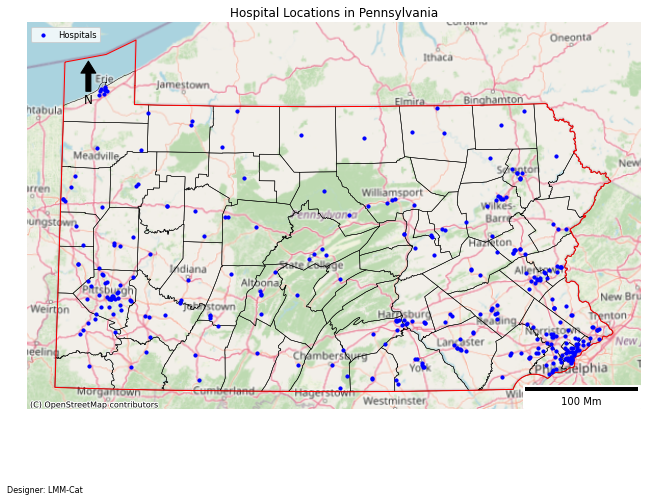

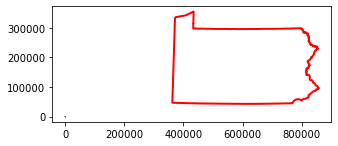

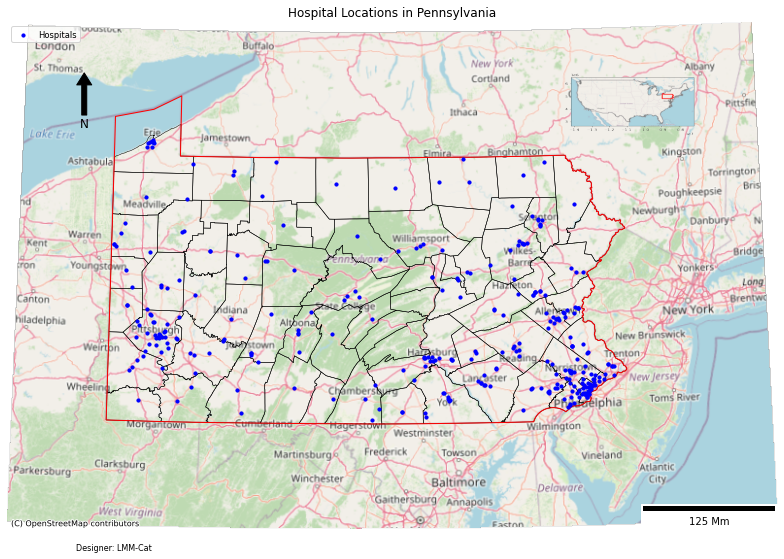

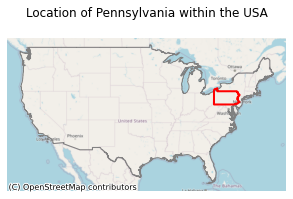

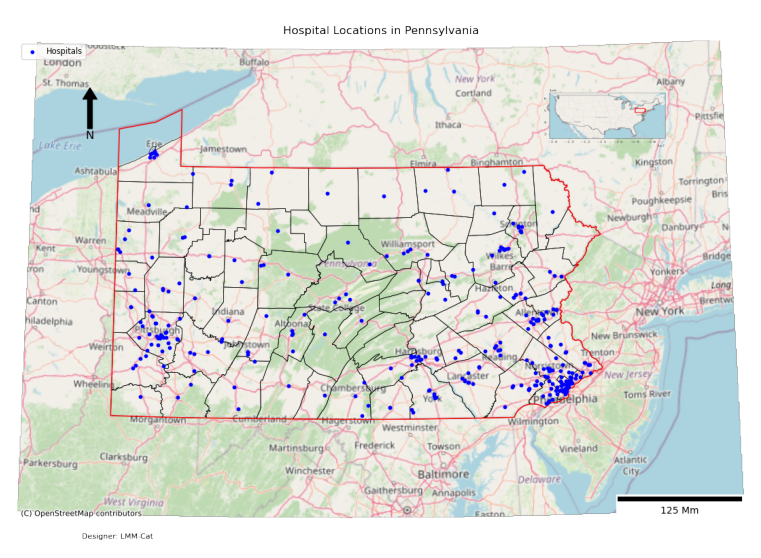

In [11]:
all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

solution.all_code = all_code

image_path = r"output_map.png"
from PIL import Image
import matplotlib.pyplot as plt

def show_map():
    image = Image.open(image_path)    
    fig, ax = plt.subplots(figsize=(15, 10))
    ax.set_axis_off()
    plt.imshow(image)
    
show_map()   
display(Code(all_code, language='python'))

In [12]:
# display(Code(all_code, language='python'))

# Beautify map

In [13]:
print(solution.get_review_prompt())

Your role: A professional cartographer. You have worked on cartography for more than 20 years and know how to design an aesthetic appeal map. Your current job is to review the map generated by AI. You need to detail the issues with the given map so that the AI can improve the map later. Note that AI makes the map via generated code, so your comments should be suitable for improvements by code. The map requirements are also provided.
 
Your task: Observe the given map carefully using the viewpoint of an experienced cartographer. 

Technical requirements: 
1. Whether the map requirements are satisfied.
2. Elaborate on one major issue only, then provide specific and actionable improvements, such as 'move the legend to the up-left to void obscuring'. If you think there is no issue, no need to mention it.
3. Whether there are obstructions between labels, annotations, axis labels, axis ticks, title, legend, scale bar, and other map elements.
4. Whether the title semantically meets the data a

## Map review

1. The map does not meet the task requirements: The scale bar is using "Mm" instead of a metric unit like meter, kilometer, or mile.
2. The title font size is too small: needs to be enlarged.
3. The legend position partially overlays the map area: move it slightly to avoid overlay.
4. The north arrow should be placed more centrally at the top to avoid overlapping text.
5. The map elements are too close together: create more space between the legend and the map.
6. The overview submap is too small and placed awkwardly: increase its size and adjust the position for better aesthetics.




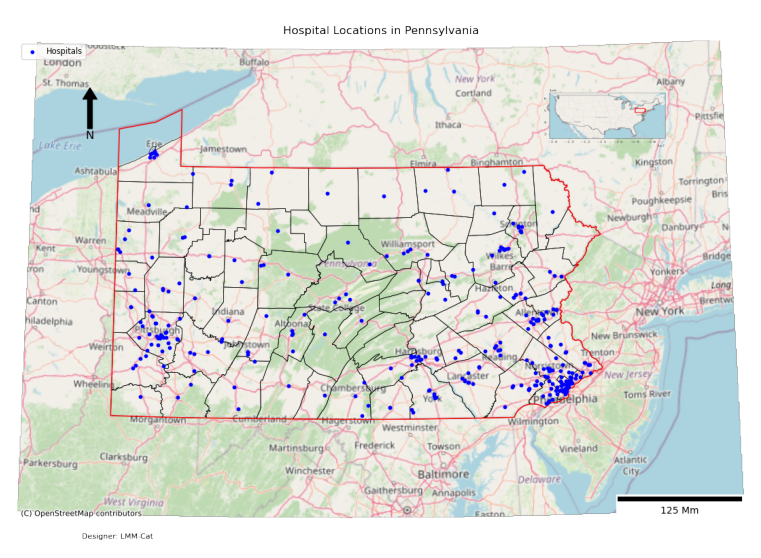

In [14]:
def encode_image(image_path):
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')

# Path to your image
image_path = r"output_map.png"

# Getting the base64 string
base64_image = encode_image(image_path)

from PIL import Image
import matplotlib.pyplot as plt

def show_map():
    image = Image.open(image_path)    
    fig, ax = plt.subplots(figsize=(15, 10))
    ax.set_axis_off()
    plt.imshow(image)


solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

show_map()

## Beautify 1

Revising the map, trial 1 / 1
1. The map does not meet the task requirements: the local map projection of metric unit is missing.
2. North arrow is too large: needs to be smaller.
3. Scale bar unit is incorrect: should be meters, miles, or km.
4. The legend overlaps with map elements: relocate to avoid obstruction.
5. The title is not centered.
6. There is no hierarchical use of fonts.
7. The overview map is too small and located awkwardly; increase size and place in an unused corner.
8. Redundant map elements: reference to contributor licenses at the bottom may not be needed.
9. Alignments between elements leave large empty spaces, which should be minimized.


### Current Map Issues

1. **Title Font Size**: The title font size is a bit small and could be more prominent.
2. **North Arrow Position**: The north arrow is too close to the edge. It should be repositioned for better clarity.
3. **Scale Bar Units**: The scale bar indicates units in "Mm" which is not suitable. It should be in 

ERROR:fiona._env:PA_hospital.gpkg: No such file or directory


 styling.





-------------- Running code (trial # 1/10) --------------


Error_info_str: 
Traceback (most recent call last):
  File "Complete program", line 109, in <module>
    assembely_solution()
  File "Complete program", line 98, in assembely_solution
    hospital_gdf = load_hospital_data()
  File "Complete program", line 33, in load_hospital_data
    hospital_gdf = gpd.read_file(hospital_data_path)
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\geopandas\io\file.py", line 297, in _read_file
    return _read_file_fiona(
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\geopandas\io\file.py", line 338, in _read_file_fiona
    with reader(path_or_bytes, **kwargs) as features:
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\fiona\env.py", line 457, in wrapper
    return f(*args, **kwds)
  File "d:\ProgramData\anaconda3\envs\llm_geo\Lib\site-packages\fiona\__init__.py", line 292, in open
    colxn = Collection(
  File "d:\ProgramData\an

Complete program:74: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  # self.data_locations_str = '\n'.join([f"{idx + 1}. {line}" for idx, line in enumerate(self.data_locations)])
Complete program:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas
except ImportError:
    install('geopandas')

try:
    import matplotlib
except ImportError:
    install('matplotlib')

try:
    import contextily
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='cyan', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False)
    ax.set_axis_off()
    ax.set_aspect('equal')
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=20)
    x, y, arrow_length = 0.9, 0.9, 0.1
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=5, headwidth=15),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower right')
    ax.add_artist(scalebar)
    ax.legend(loc='upper right', fontsize='small')
    fig.text(0.85, 0.02, 'Designer: LMM-Cat', fontsize=8, va='bottom', ha='right')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(5, 5))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=1)
    state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=2)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857')
    ax.set_axis_off()
    ax.set_title("Location of Pennsylvania within the USA", pad=10)
    return fig

def combine_maps(enhanced_map_canvas, overview_map):
    m

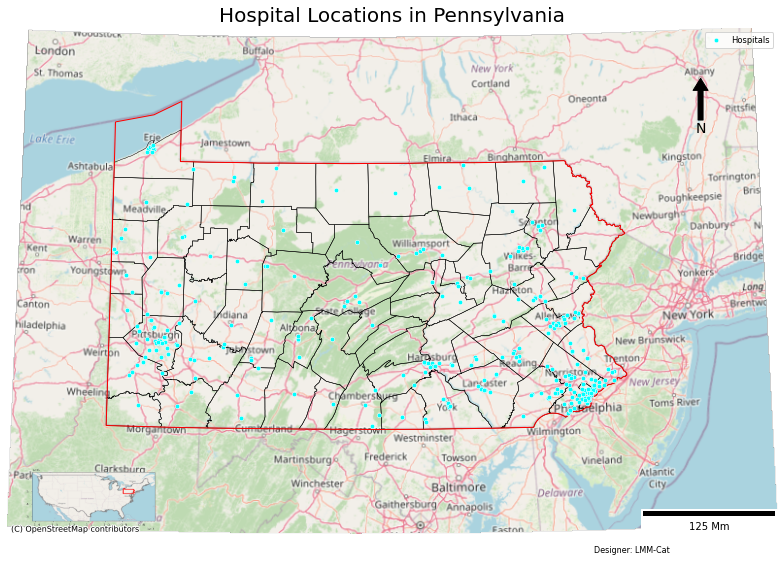

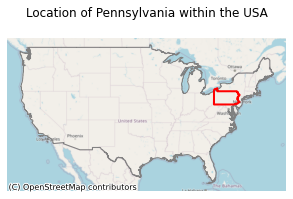

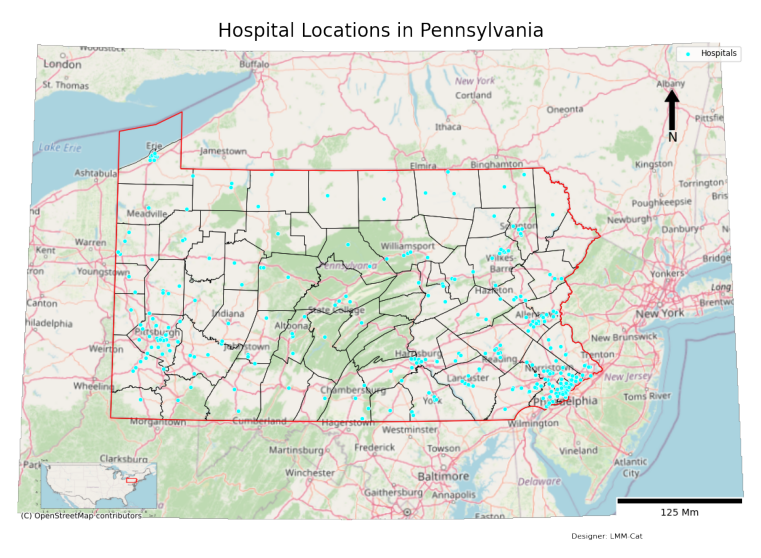

In [15]:
# solution.get_beautify_text_prompt(solution.all_code)

def encode_image(image_path):
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')
 
 
# def encode_image(image_path):
#   with open(image_path, "rb") as image_file:
#     return base64.b64encode(image_file.read()).decode('utf-8')

  
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 2

Revising the map, trial 1 / 1
1. The main issue is the legend and north arrow position: they overlap with the map area, causing confusion. Move the legend to the lower-right corner and the north arrow to the upper-left to avoid obscuring the map features.
2. Map projection issue: Data use is EPSG 4326, not a local metric projection. Convert to an appropriate local UTM zone for better accuracy.
3. The scale bar unit is displayed as "Mm": Change the unit to "km" for correctness.
4. The map title is suitable but could be slightly larger for emphasis.
5. The overview submap is present but not clearly defined. Increase the boundary contrast.
6. The north arrow points correctly upward.
7. Elements like the scale bar and legend are slightly too small and difficult to read; they should be proportionate to the map size.
8. Ensure there’s no excessive empty space around elements to improve use of space.


Current map issues:
1. The color of hospital points does not stand out enough against the b

Complete program:75: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.data_locations_str =  self.data_locations
Complete program:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  def get_LLM_reply(self,




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas
except ImportError:
    install('geopandas')

try:
    import matplotlib
except ImportError:
    install('matplotlib')

try:
    import contextily
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='darkblue', edgecolor='white', linewidth=0.5, markersize=30, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False)
    ax.set_axis_off()
    ax.set_aspect('equal')
    fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=24)
    x, y, arrow_length = 0.95, 0.95, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=15),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='top')
    ax.add_artist(scalebar)
    ax.legend(loc='upper left', fontsize='medium')
    fig.text(0.85, 0.02, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='right')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(5, 5))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=1)
    state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=2)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857')
    ax.set_axis_off()
    ax.set_title("Location of Pennsylvania withi

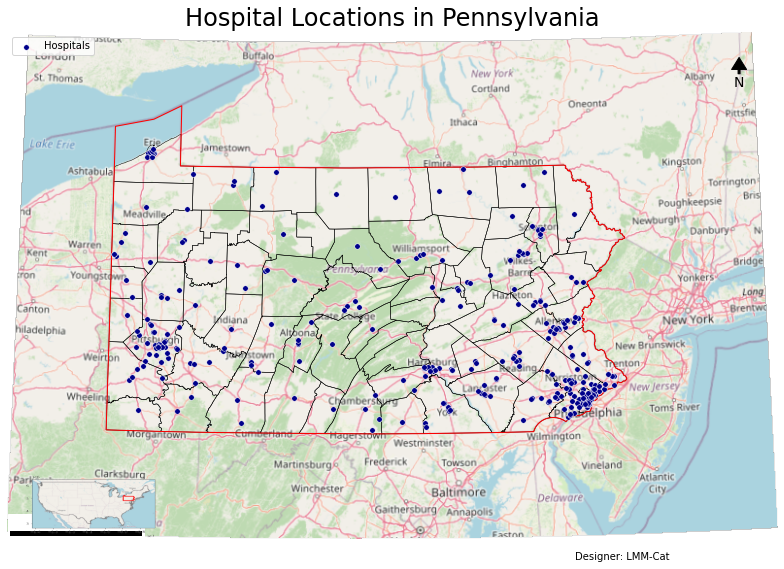

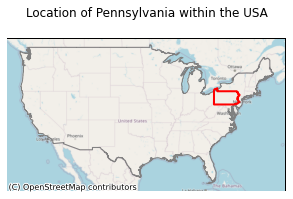

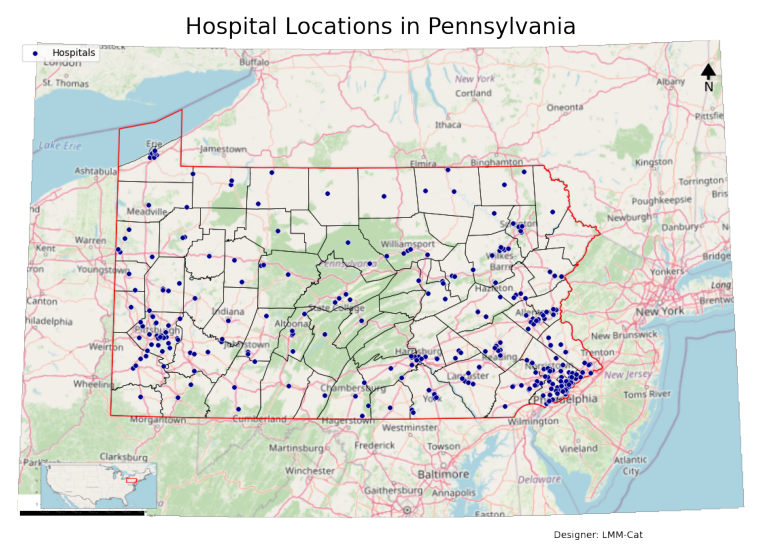

In [16]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 3

Revising the map, trial 1 / 1
1. The local map projection is not in metric units; change to a relevant local projection that uses meters.
2. The overview submap is obstructing important map details: relocate it to the bottom right corner.
3. The legend size is too large and overlaps with the map border: resize and place it in the bottom left corner.
4. Fonts used for city labels are too small: increase font size for readability.
5. The scale bar unit is not displayed: add "km" for clarity.
6. Large empty spaces around the map: center map to utilize space more effectively.
7. The title font size is too small: enlarge for better visibility.
8. North arrow is correctly oriented but too small: increase size for clarity.
9. Redundant design element: remove the outline of the state polygon to avoid clutter.


Current map issues:
1. Overlapping map elements causing clutter, such as the legend and scalebar.
2. North arrow positioning not ideal.
3. The overview map integration appears off.
4. L

Complete program:74: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  # self.data_locations_str = '\n'.join([f"{idx + 1}. {line}" for idx, line in enumerate(self.data_locations)])
Complete program:95: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.chat_history = [{'role': 'system', 'content': role}]




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas
except ImportError:
    install('geopandas')

try:
    import matplotlib
except ImportError:
    install('matplotlib')

try:
    import contextily
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='darkblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.5)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=20, pad=15)
    x, y, arrow_length = 0.1, 0.95, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='bottom', box_alpha=0.5)
    ax.add_artist(scalebar)
    ax.legend(loc='upper right', fontsize='small', frameon=False)
    fig.text(0.9, 0.03, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='right')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(4, 4))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.6)
    ax.set_axis_off()
    ax.set

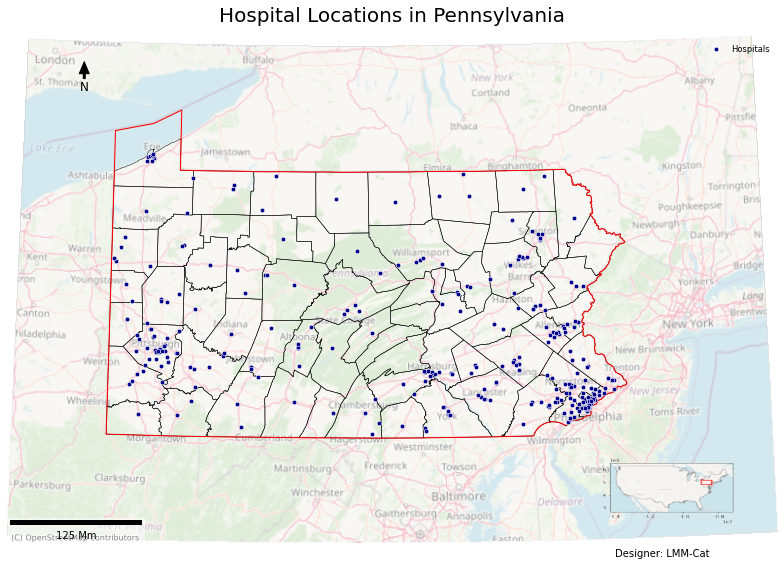

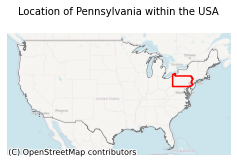

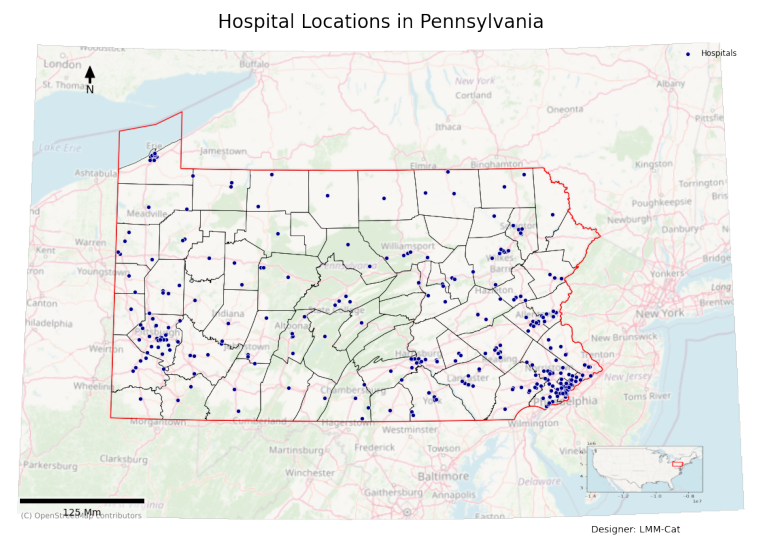

In [17]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 4

Revising the map, trial 1 / 1
1. The scale bar's unit is incorrect: change "mm" to "km."
2. The legend and map are too close: increase spacing for clarity.
3. The overview submap is quite small: enlarge for better visibility.
4. The title font size could be increased for better readability.
5. The north arrow is slightly misaligned: adjust direction to true north.
6. The map is not centered: adjust map position to center.
7. The OpenStreetMap credit overlays with the scale bar: increase spacing.


Current map issues:
1. The overview map's legend is missing, and its position could be better aligned.
2. The scale bar unit is incorrect (Mm instead of km).
3. The north arrow positioning can be improved for better aesthetics.
4. The main map title lacks emphasis due to size and location.
5. The color scheme could use stronger contrasts to enhance readability.
6. There’s no alignment between map elements like legends, titles, and annotations.
7. Designer credit could be better placed for vis

Complete program:74: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  # self.data_locations_str = '\n'.join([f"{idx + 1}. {line}" for idx, line in enumerate(self.data_locations)])


Error_info_str: 
Traceback (most recent call last):
  File "Complete program", line 110, in <module>
    assembely_solution()
  File "Complete program", line 107, in assembely_solution
    final_map = combine_maps(enhanced_main_map_canvas, overview_map)
  File "Complete program", line 92, in combine_maps
    overview_map_canvas, _ = create_overview_map(load_usa_boundary(), load_state_boundary())
TypeError: cannot unpack non-iterable Figure object

Sending error information to LLM for debugging...
Upon reviewing the given code, the error occurs because the `create_overview_map` function returns a single Figure object, not a tuple with two items as expected by `combine_maps`. Additionally, there are a few other aspects to consider for improvement:

1. When adding the overview map as an inset, we should plot the GeoDataFrames again instead of copying the canvas, to correctly render the inset map.
2. The `create_overview_map` function should be adjusted to return both the Figure and Axes i

Complete program:74: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  # self.data_locations_str = '\n'.join([f"{idx + 1}. {line}" for idx, line in enumerate(self.data_locations)])


Error_info_str: 
Traceback (most recent call last):
  File "Complete program", line 114, in <module>
    assembely_solution()
  File "Complete program", line 111, in assembely_solution
    final_map = combine_maps(enhanced_main_map_canvas, overview_map_canvas)
  File "Complete program", line 94, in combine_maps
    overview_ax.plot(*geom.exterior.xy, color='gray', linewidth=0.5)
AttributeError: 'MultiPolygon' object has no attribute 'exterior'

Sending error information to LLM for debugging...
To address the error in the code, we need to handle the situation where a 'MultiPolygon' object is used, which doesn't have an 'exterior' attribute directly. Instead, we need to iterate over each constituent polygon in the 'MultiPolygon' and plot their boundaries. Also, the code should ensure proper usage of the basemap and map sizing.

Let's correct the code step by step:

1. Import required packages and ensure they are installed if missing.
2. Ensure all spatial layers being plotted use a consi

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  ):




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=24, pad=20, loc='left')
    x, y, arrow_length = 0.95, 0.95, 0.08
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower right', scale_loc='bottom', box_alpha=0.5)
    ax.add_artist(scalebar)
    ax.legend(loc='upper left', fontsize='small', frameon=True)
    fig.text(0.5, 0.03, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(4, 4))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.5)
    ax.set_axis_off()
    ax.set_title("Location of Pennsylvania wit

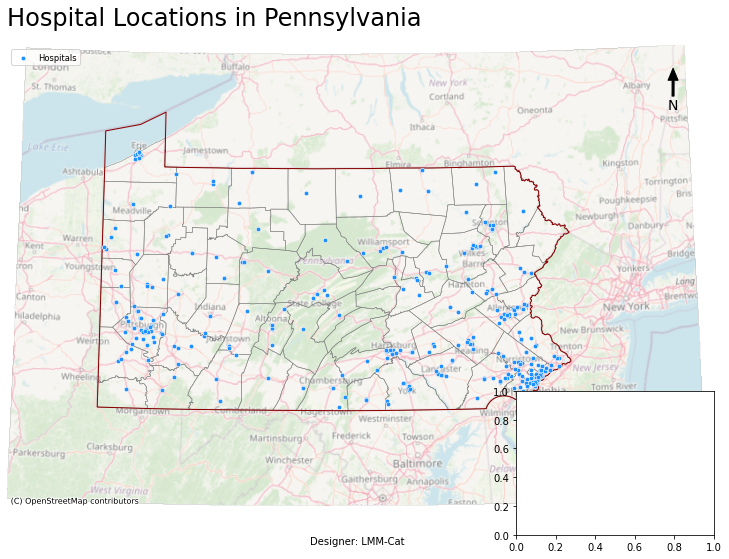

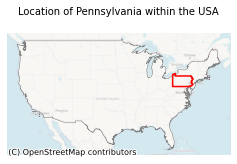

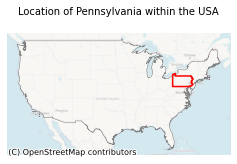

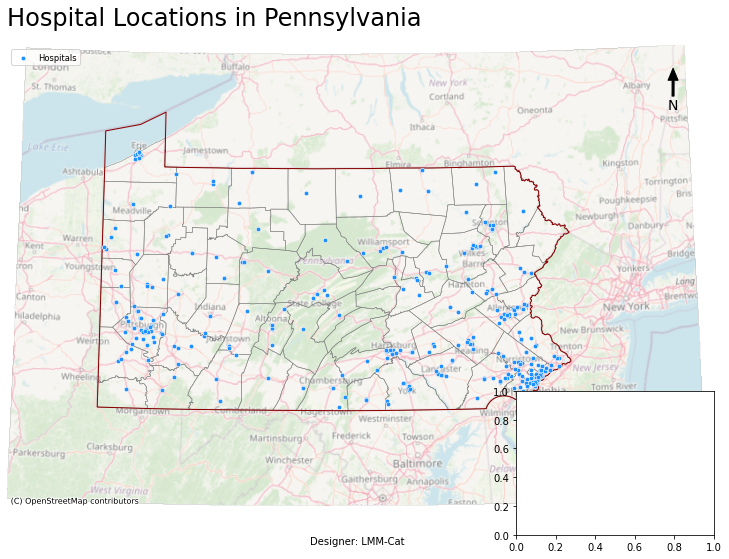

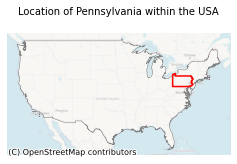

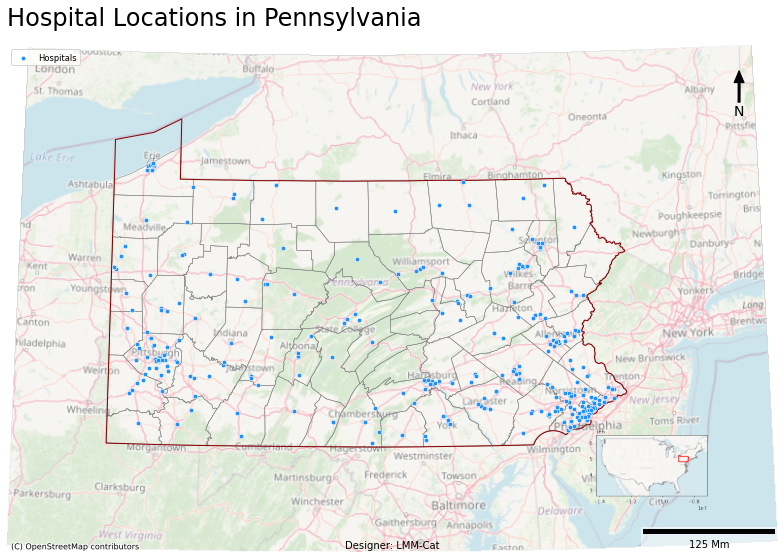

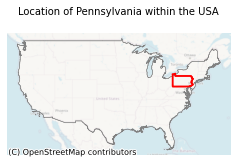

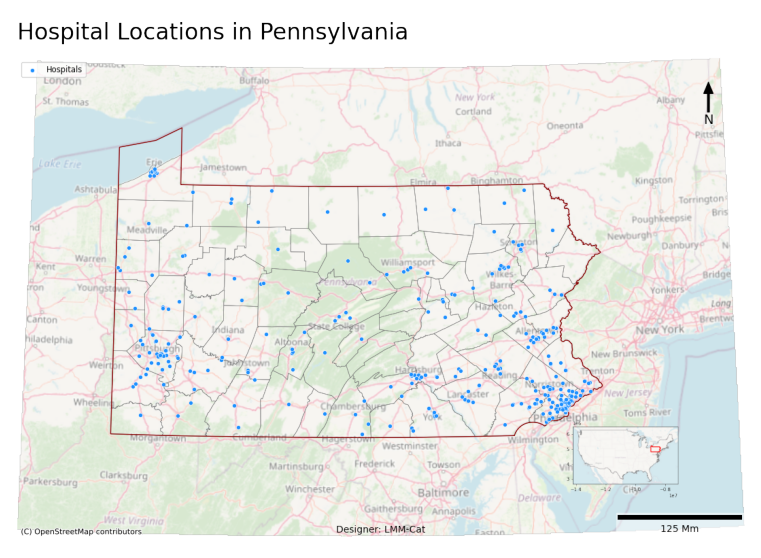

In [18]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 5

Revising the map, trial 1 / 1
1. The overview sub-map does not appropriately show the location of Pennsylvania within the USA. It needs to be larger and placed in a more visible spot.
2. The scale bar unit is incorrect; it should be in meters, miles, or kilometers.
3. The map elements are not centrally aligned, leading to a lack of balance.
4. The font sizes lack hierarchy, making it difficult to distinguish between different elements.
5. The legend obscures part of the map, which affects readability; relocate it to avoid overlapping.
6. There's a large empty space on the right; adjust map elements to eliminate this.
7. Ensure the north arrow direction is pointing straight up for consistency.
8. Convert the map projection to a local metric one as required.


Current map issues:
1. The scale bar's unit is incorrect ('Mm'), and it should be in 'km'.
2. The overview map inset is not clearly visible.
3. The legend position might overlap with the map contents.
4. The north arrow is awkwardl

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  ):




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=18, pad=20, loc='center')
    x, y, arrow_length = 0.95, 0.95, 0.08
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower right', scale_loc='bottom', box_alpha=0.5)
    ax.add_artist(scalebar)
    ax.legend(loc='upper left', fontsize='small', frameon=True)
    fig.text(0.5, 0.03, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(4, 4))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.boundary.plot(ax=ax, edgecolor='red', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.5)
    ax.set_axis_off()
    ax.set_title("Location of Pennsylvania w

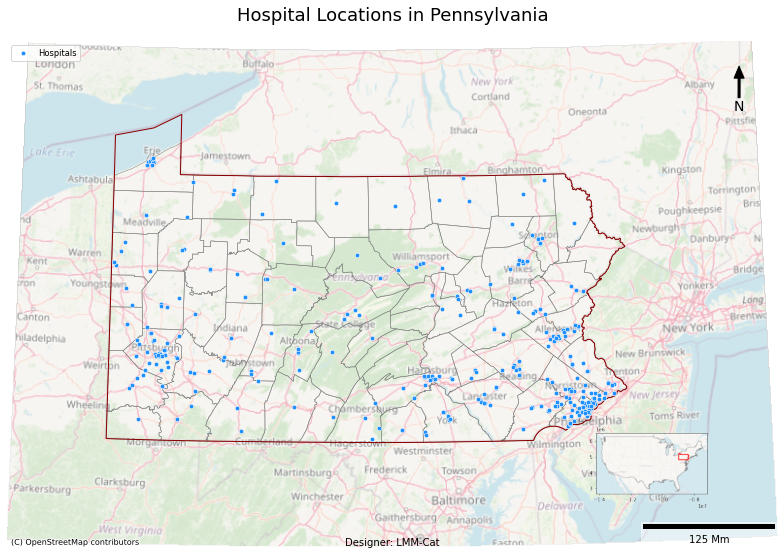

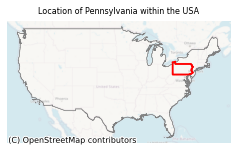

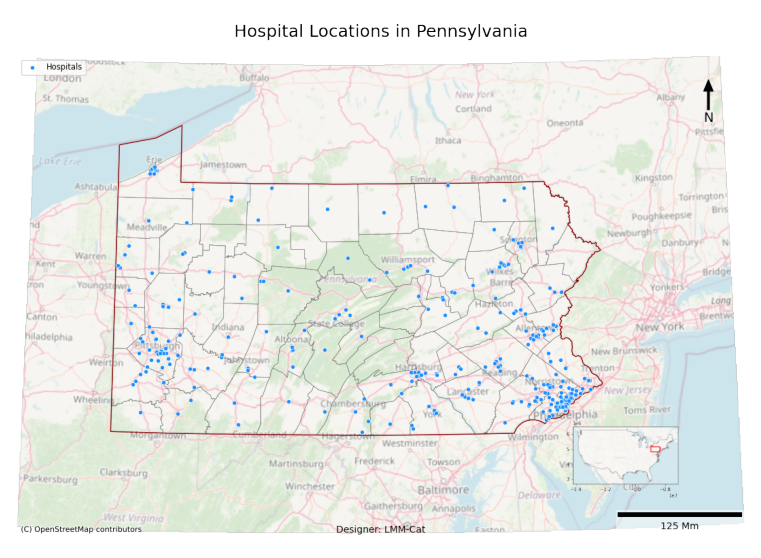

In [19]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 6

Revising the map, trial 1 / 1
1. The scale bar unit is incorrect; it should be in meters, miles, or kilometers, not "Mm".
2. The legend position could be adjusted to not obscure map details; consider moving it to the bottom right.
3. There is no local map projection indicated; ensure all data is projected using a local metric unit.
4. The overview submap borders appear too thick; consider reducing the border size for better aesthetics.
5. The font size of "Designer: LMM-Cat" is too small; increase it for improved visibility.
6. The north arrow is too close to the map edge; reposition it to ensure clarity.
7. Align elements more harmoniously to avoid large empty spaces.


Current map issues:
1. The north arrow is placed too close to the edge of the map, making it less visible.
2. The scale bar is short and incorrectly labeled in "Mm" instead of "km".
3. The overview map does not clearly highlight Pennsylvania.
4. Legend placement could be more optimal for clarity.
5. The map title font 

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.5)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=22, pad=20, loc='center')
    x, y, arrow_length = 0.95, 0.90, 0.08
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower right', scale_loc='bottom', box_alpha=0.5, length_fraction=0.2)
    ax.add_artist(scalebar)
    ax.legend(loc='upper right', fontsize='medium', frameon=True)
    fig.text(0.5, 0.03, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(4, 4))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.3)
    ax.set_axis_off()
    ax

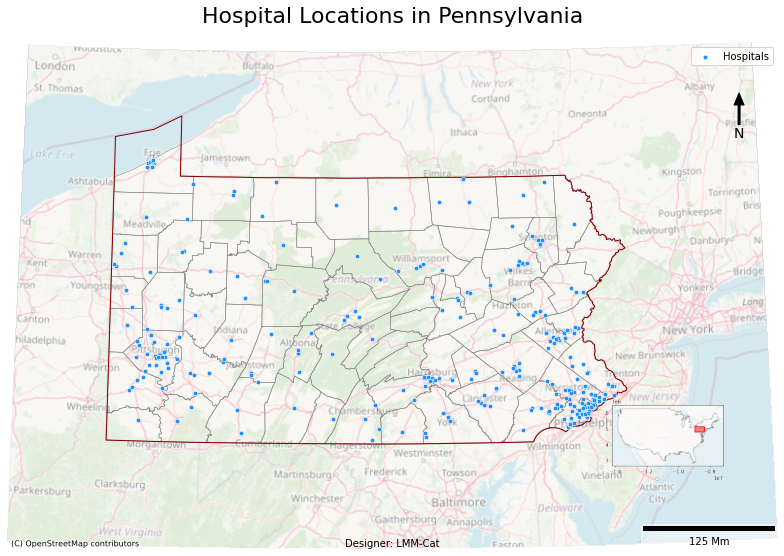

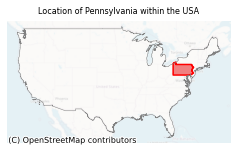

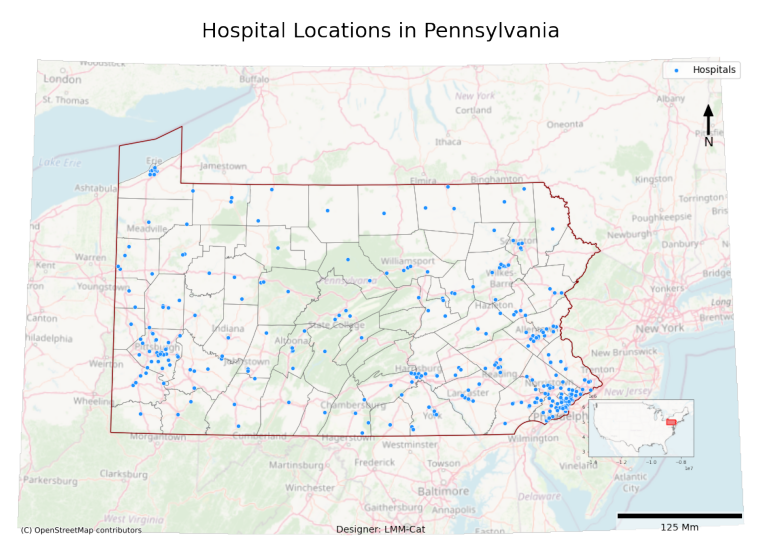

In [20]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 7

Revising the map, trial 1 / 1
1. The scale bar unit is incorrect: it should be in meters, miles, or kilometers, not millimeters.
2. The north arrow is not clearly positioned or visible.
3. The map is slightly off-center: recenter it for better balance.
4. Font sizes and styles for labels and titles lack hierarchy: adjust to create emphasis where needed.
5. The legend is too close to the north arrow: increase spacing for clarity.
6. The overview sub-map's border blends into the map and could be more distinct.
7. The map's projection should be in a local metric unit.
8. The scale bar position could be better aligned with other map elements for a cohesive look.
9. The basemap transparency could be adjusted to better highlight the hospital locations.


Current map issues:
1. The title does not stand out due to its color and font style.
2. The north arrow and scale bar are too close to each other and the map's edge.
3. The legend is overlapping with the map and is not well-aligned.
4. The o

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.direct_request_LLM_response = ''




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=24, fontweight='bold', pad=20, loc='center')
    x, y, arrow_length = 0.95, 0.92, 0.06
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=14, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='bottom', box_alpha=0.5, length_fraction=0.2)
    ax.add_artist(scalebar)
    ax.legend(loc='upper left', fontsize='medium', frameon=True)
    fig.text(0.5, 0.04, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(3, 3))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.3)
    ax.set_

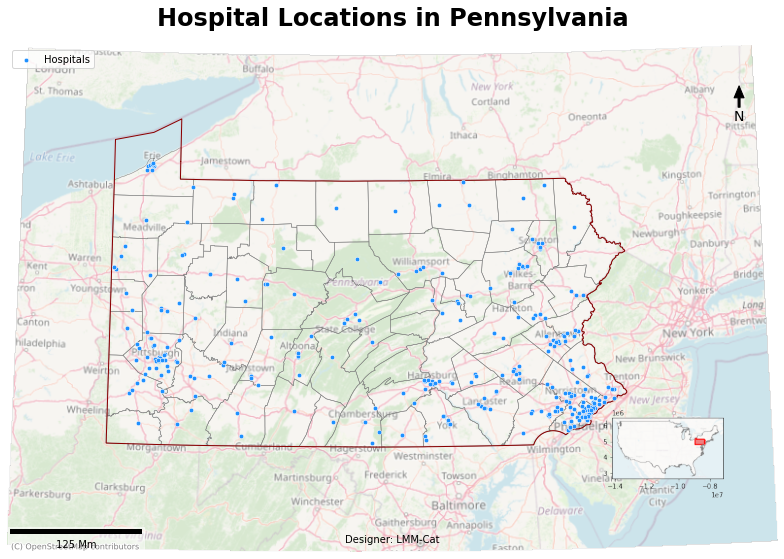

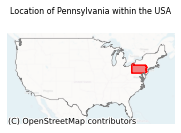

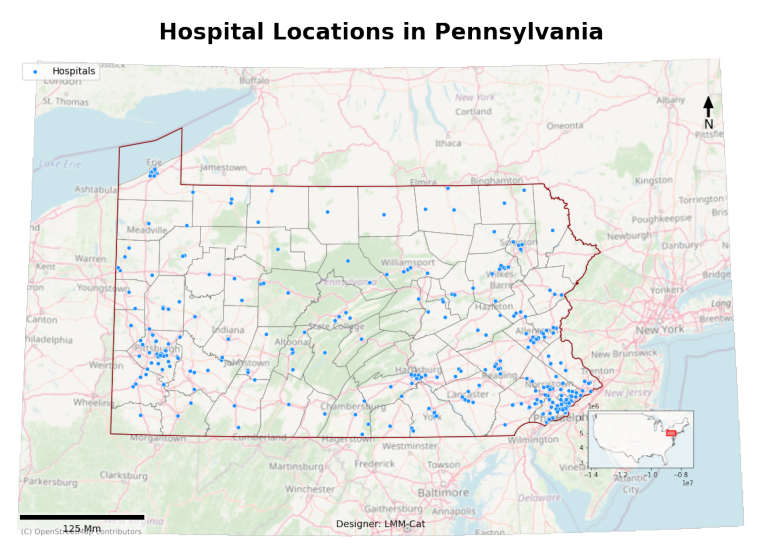

In [21]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 8

Revising the map, trial 1 / 1
1. The map does not meet task requirement 3: A local map projection of metric unit is needed.
2. The scale bar uses '125 Miles': it should be in meters or kilometers.
3. The legend label overlaps the map border: move it to avoid obstruction.
4. The title font size is slightly too large compared to other elements: reduce for better hierarchy.
5. The overview submap border is too bold compared to the map content: reduce thickness.
6. The north arrow is slightly overlapping with content: reposition to top-left for clarity.
7. Consider balancing space between map elements to avoid large empty areas.
8. The legend and scale bar are too close: increase spacing for readability.


Current map issues:
1. The north arrow placement is too far from the main map area and should be more intuitive.
2. The scale bar is a bit small compared to the map layout and lacks clear labeling for distances.
3. The title font size might be too overwhelming relative to other elements.

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.direct_request_LLM_response = ''




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=18, fontweight='bold', pad=20, loc='center')
    x, y, arrow_length = 0.95, 0.88, 0.06
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='bottom', box_alpha=0.5, length_fraction=0.25)
    ax.add_artist(scalebar)
    legend = ax.legend(loc='upper right', fontsize='medium', frameon=True, facecolor='white', framealpha=0.7)
    fig.text(0.5, 0.04, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(3, 3))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.M

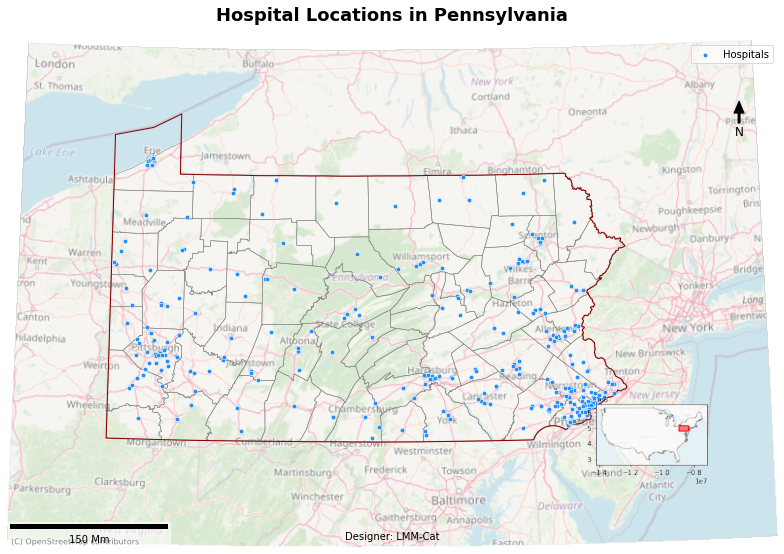

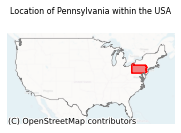

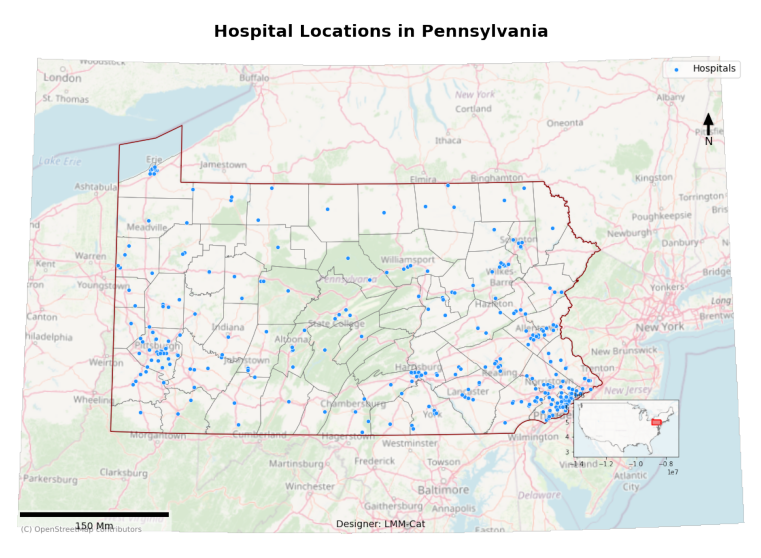

In [22]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 9

Revising the map, trial 1 / 1
1. The map projection is not in a local metric unit; it remains in EPSG 4326. Suggest using a local projection such as NAD83 / Pennsylvania (US Feet) or similar.
2. The scale bar unit is in "Mm" instead of a more appropriate unit like miles or kilometers; adjust the scale bar unit to reflect this correctly.
3. The north arrow is too small and hard to notice; increase its size for better visibility.
4. The map title font size is too large relative to other elements and could be decreased slightly for better balance.
5. The legend position is overlapping with the map border and should be moved inward to avoid any obstruction.
6. The overview map is too close to the edge of the main map; increasing the space between them can enhance legibility.
7. The scale bar is partly obstructing the copyright notice; adjust its position or size to avoid overlay.
8. The map is slightly off-center, skewed to the right; it should be centered more accurately within the layout

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.direct_request_LLM_response = ''




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=20, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=22, fontweight='bold', pad=20, loc='center')
    x, y, arrow_length = 0.95, 0.85, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='bottom', box_alpha=0.5, length_fraction=0.2)
    ax.add_artist(scalebar)
    legend = ax.legend(loc='lower right', fontsize='medium', frameon=True, facecolor='white', framealpha=0.7)
    fig.text(0.5, 0.02, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(3, 3))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Ma

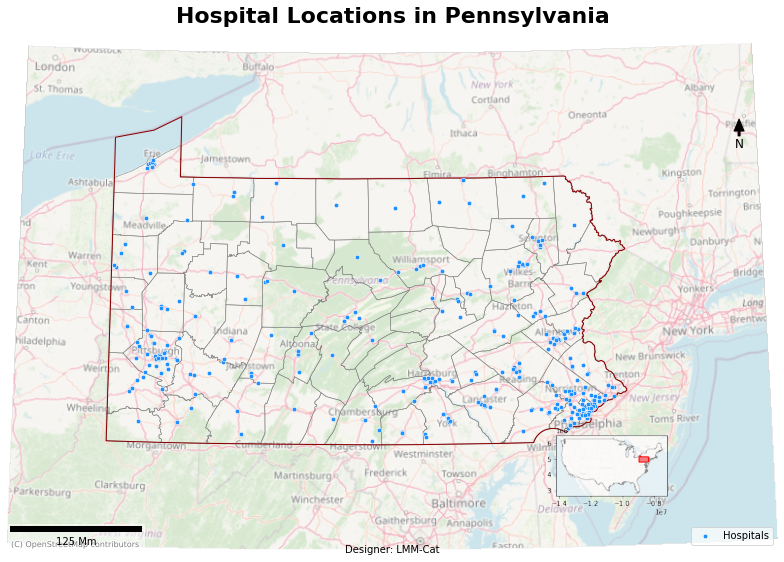

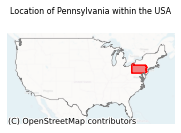

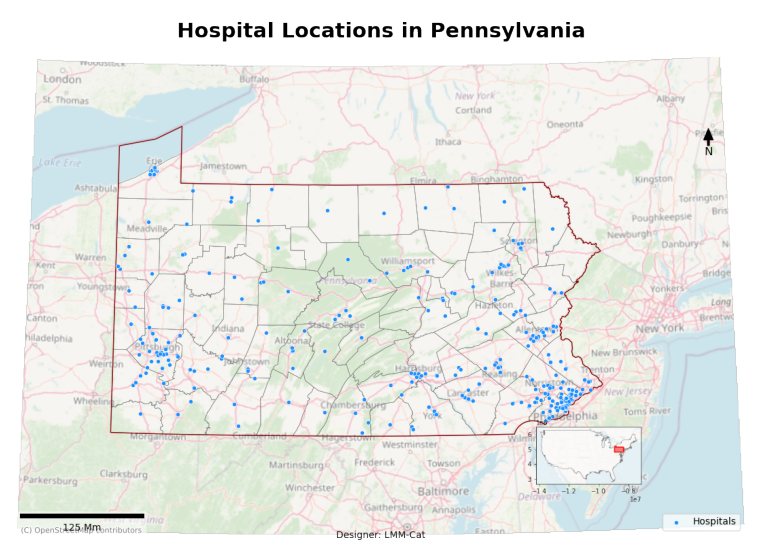

In [23]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

## Beautify 10

Revising the map, trial 1 / 1
1. The map projection is not local and in metric units; it's still in EPSG 4326 (WGS 84).
2. The overview submap is awkwardly placed and too small; increase its size and move it to a less intrusive position.
3. The north arrow overlaps with the map border; reposition it to be fully within the map.
4. The scale bar is incorrect; ensure it reflects an accurate metric distance.
5. Reduce the font size of "Designer: LMM-Cat" for better hierarchy.
6. There is a large empty space between the map and the title; adjust vertical alignment.
7. Use the same colormap style in legend and map for consistency.
8. The legend is too close to the bottom edge; increase spacing.


Current map issues:
1. The north arrow position obscures map details; it needs repositioning.
2. The scale bar unit "Mm" is incorrect; it should be km or miles.
3. The overview map placement at the bottom right may cover data; consider moving it.
4. The legend might blend with the map background. Ad

Complete program:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  self.graph_prompt = ""
Complete program:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  self.direct_request_LLM_response = ''




--------------- Done ---------------




import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=30, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=22, fontweight='bold', pad=20, loc='center')
    x, y, arrow_length = 0.05, 0.95, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='km', location='lower left', scale_loc='bottom', box_alpha=0.5, length_fraction=0.2)
    ax.add_artist(scalebar)
    legend = ax.legend(loc='lower right', fontsize='medium', frameon=True, facecolor='white', framealpha=0.7, edgecolor='black')
    fig.text(0.5, 0.02, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(3, 3))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.provide

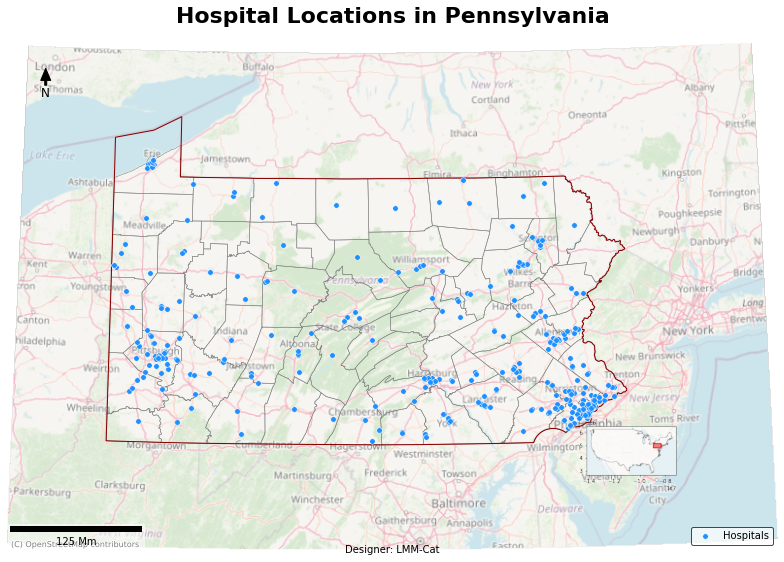

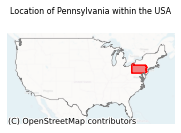

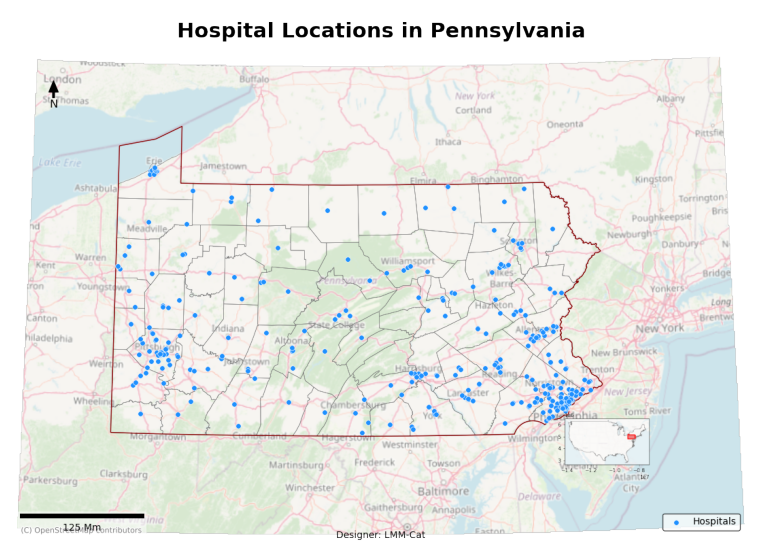

In [24]:
beautify_cnt = 1

for i in range(beautify_cnt):
    
    print(f"Revising the map, trial {i + 1} / {beautify_cnt}")
    
    base64_image = encode_image(image_path)
    
    solution.ask_LLM_to_review_map(map_base64=base64_image, model='gpt-4o')

    solution.ask_LLM_to_beautify_map(map_base64=base64_image, model='gpt-4o')

    all_code = solution.execute_complete_program(code=solution.all_code, try_cnt=10)

    solution.all_code = all_code
    
    solution.save_solution()

show_map()
display(Code(all_code, language='python'))

In [25]:
STOP

NameError: name 'STOP' is not defined

# Tools


## load a solution

In [ ]:

# import pickle

# saved_fname = r"D:\OneDrive_PSU\OneDrive - The Pennsylvania State University\Research_doc\LLM-Cat\Census_map\Census_map.pkl"
# file = open(saved_fname, 'rb')

# solution = pickle.load(file)

# file.close()
# print(solution.task)

C:\Users\USER\AppData\Local\Temp\ipykernel_15492\3756368770.py:73: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  legend = ax.legend(loc='lower right', fontsize='medium', frameon=True, facecolor='white', framealpha=0.7, edgecolor='black')
C:\Users\USER\AppData\Local\Temp\ipykernel_15492\3756368770.py:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  main_fig.tight_layout()


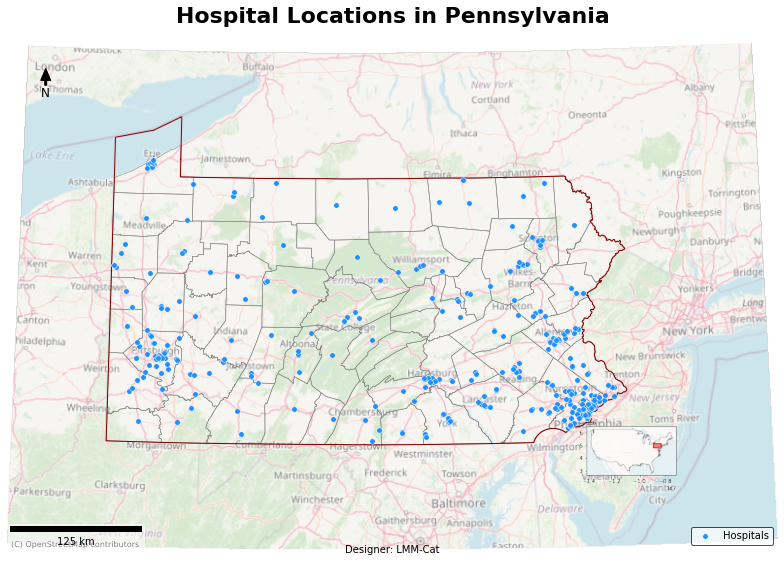

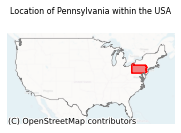

In [34]:
import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

try:
    import geopandas as gpd
except ImportError:
    install('geopandas')

try:
    import matplotlib.pyplot as plt
except ImportError:
    install('matplotlib')

try:
    import contextily as ctx
except ImportError:
    install('contextily')

try:
    import matplotlib_scalebar
except ImportError:
    install('matplotlib_scalebar')

from matplotlib_scalebar.scalebar import ScaleBar

def load_hospital_data(hospital_data_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_hospital.gpkg'):
    hospital_gdf = gpd.read_file(hospital_data_path)
    return hospital_gdf

def load_county_boundary(county_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_County_boundary.gpkg'):
    county_boundary_gdf = gpd.read_file(county_boundary_path)
    return county_boundary_gdf

def load_state_boundary(state_boundary_path='D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\PA_State_boundary.gpkg'):
    state_boundary_gdf = gpd.read_file(state_boundary_path)
    return state_boundary_gdf

def load_usa_boundary(usa_boundary_path="D:\\OneDrive_PSU\\OneDrive - The Pennsylvania State University\\Research_doc\\LLM-Cat\\Data\\USA_boundary.gpkg"):
    usa_boundary_gdf = gpd.read_file(usa_boundary_path)
    return usa_boundary_gdf

def local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf):
    pa_projection = 'EPSG:32129'  # Pennsylvania South projection
    hospital_projected_gdf = hospital_gdf.to_crs(pa_projection)
    county_boundary_projected_gdf = county_boundary_gdf.to_crs(pa_projection)
    state_boundary_projected_gdf = state_boundary_gdf.to_crs(pa_projection)
    return hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf

def setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf):
    fig, ax = plt.subplots(figsize=(11, 8))
    county_boundary_projected_gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.5, label='County Boundaries')
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='darkred', facecolor='none', linewidth=1, label='State Boundary')
    hospital_projected_gdf.plot(ax=ax, color='dodgerblue', edgecolor='white', linewidth=0.5, markersize=30, label='Hospitals')
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32129', reset_extent=False, alpha=0.6)
    ax.set_axis_off()
    fig.subplots_adjust(left=0.05, right=0.95, top=0.90, bottom=0.1)
    return fig, ax

def add_map_elements(map_canvas):
    fig, ax = map_canvas
    ax.set_title('Hospital Locations in Pennsylvania', fontsize=22, fontweight='bold', pad=20, loc='center')
    x, y, arrow_length = 0.05, 0.95, 0.05
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=2, headwidth=10),
                ha='center', va='center', fontsize=12, xycoords=ax.transAxes)
    scalebar = ScaleBar(1, units='m', location='lower left', scale_loc='bottom', box_alpha=0.5, length_fraction=0.2)
    # scalebar.unit = "m"

    ax.add_artist(scalebar)
    legend = ax.legend(loc='lower right', fontsize='medium', frameon=True, facecolor='white', framealpha=0.7, edgecolor='black')
    fig.text(0.5, 0.02, 'Designer: LMM-Cat', fontsize=10, va='bottom', ha='center')
    return fig, ax

def create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf):
    usa_boundary_gdf = usa_boundary_gdf.to_crs('EPSG:3857')
    state_boundary_projected_gdf = state_boundary_projected_gdf.to_crs('EPSG:3857')
    fig, ax = plt.subplots(figsize=(3, 3))
    usa_boundary_gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    state_boundary_projected_gdf.plot(ax=ax, edgecolor='red', facecolor='lightcoral', linewidth=1.5)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:3857', alpha=0.3)
    ax.set_axis_off()
    ax.set_title("Location of Pennsylvania within the USA", fontsize=8, pad=8)
    return fig, ax

def combine_maps(enhanced_map_canvas, overview_map_canvas):
    main_fig, main_ax = enhanced_map_canvas
    overview_fig, overview_ax = overview_map_canvas
    inset_ax = main_fig.add_axes([0.7, 0.1, 0.2, 0.2], zorder=10)
    inset_ax.imshow(overview_fig.canvas.buffer_rgba())
    inset_ax.set_axis_off()
    main_fig.tight_layout()
    return main_fig

def assembely_solution():
    hospital_gdf = load_hospital_data()
    county_boundary_gdf = load_county_boundary()
    state_boundary_gdf = load_state_boundary()
    usa_boundary_gdf = load_usa_boundary()
    hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf = local_projection(hospital_gdf, county_boundary_gdf, state_boundary_gdf)
    main_map_canvas = setup_map_canvas(hospital_projected_gdf, county_boundary_projected_gdf, state_boundary_projected_gdf)
    enhanced_main_map_canvas = add_map_elements(main_map_canvas)
    overview_map_canvas = create_overview_map(usa_boundary_gdf, state_boundary_projected_gdf)
    final_map = combine_maps(enhanced_main_map_canvas, overview_map_canvas)
    final_map.savefig('output_map.png', dpi=100)

assembely_solution()